In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
HOME = os.getcwd()
print("HOME:", HOME)

HOME: /content


In [ ]:
!pip install -q 'git+https://github.com/facebookresearch/segment-anything.git'

  Preparing metadata (setup.py) ... done


In [ ]:
!pip install -q jupyter_bbox_widget roboflow dataclasses-json supervision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 367.8/367.8 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.9/76.9 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.7/135.7 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.2/49.2 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 1.2 MB/s eta 0:00:00


In [ ]:
!mkdir -p {HOME}/weights
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P {HOME}/weights

In [ ]:
import os

CHECKPOINT_PATH = os.path.join(HOME, "weights", "sam_vit_h_4b8939.pth")
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

/content/weights/sam_vit_h_4b8939.pth ; exist: True


In [ ]:
import torch

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"

In [ ]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

In [ ]:
mask_generator = SamAutomaticMaskGenerator(sam)

In [ ]:
import cv2
import supervision as sv

In [ ]:
import numpy as np

In [ ]:
import numpy as np
from dataclasses import dataclass
from typing import List, Tuple, Union, Optional
from dataclasses_json import dataclass_json
from supervision import Detections


@dataclass_json
@dataclass
class COCOCategory:
    id: int
    name: str
    supercategory: str


@dataclass_json
@dataclass
class COCOImage:
    id: int
    width: int
    height: int
    file_name: str
    license: int
    date_captured: str
    coco_url: Optional[str] = None
    flickr_url: Optional[str] = None


@dataclass_json
@dataclass
class COCOAnnotation:
    id: int
    image_id: int
    category_id: int
    segmentation: List[List[float]]
    area: float
    bbox: Tuple[float, float, float, float]
    iscrowd: int


@dataclass_json
@dataclass
class COCOLicense:
    id: int
    name: str
    url: str


@dataclass_json
@dataclass
class COCOJson:
    images: List[COCOImage]
    annotations: List[COCOAnnotation]
    categories: List[COCOCategory]
    licenses: List[COCOLicense]


def load_coco_json(json_file: str) -> COCOJson:
    import json

    with open(json_file, "r") as f:
        json_data = json.load(f)

    return COCOJson.from_dict(json_data)


class COCOJsonUtility:
    @staticmethod
    def get_annotations_by_image_id(coco_data: COCOJson, image_id: int) -> List[COCOAnnotation]:
        return [annotation for annotation in coco_data.annotations if annotation.image_id == image_id]

    @staticmethod
    def get_annotations_by_image_path(coco_data: COCOJson, image_path: str) -> Optional[List[COCOAnnotation]]:
        image = COCOJsonUtility.get_image_by_path(coco_data, image_path)
        if image:
            return COCOJsonUtility.get_annotations_by_image_id(coco_data, image.id)
        else:
            return None

    @staticmethod
    def get_image_by_path(coco_data: COCOJson, image_path: str) -> Optional[COCOImage]:
        for image in coco_data.images:
            if image.file_name == image_path:
                return image
        return None

    @staticmethod
    def annotations2detections(annotations: List[COCOAnnotation]) -> Detections:
        class_id, xyxy = [], []

        for annotation in annotations:
            x_min, y_min, width, height = annotation.bbox
            class_id.append(annotation.category_id)
            xyxy.append([
                x_min,
                y_min,
                x_min + width,
                y_min + height
            ])

        return Detections(
            xyxy=np.array(xyxy, dtype=int),
            class_id=np.array(class_id, dtype=int)
        )

In [ ]:
import os

# Paths to your datasets on Google Drive
BASE_PATH = '/content/drive/My Drive'
SHADOW_DATASET_PATH = os.path.join(BASE_PATH, 'shadow-dataset')
BRIGHTDARK_DATASET_PATH = os.path.join(BASE_PATH, 'brightdark-dataset')

# Shadow dataset paths
SHADOW_IMAGES_PATH = os.path.join(SHADOW_DATASET_PATH, 'shadow-images')
SHADOW_LABELS_PATH = os.path.join(SHADOW_DATASET_PATH, 'shadow-masks')

# Brightdark dataset paths
BRIGHTDARK_IMAGES_PATH = os.path.join(BRIGHTDARK_DATASET_PATH, 'brightdark-images')
BRIGHTDARK_LABELS_PATH = os.path.join(BRIGHTDARK_DATASET_PATH, 'brightdark-masks')

# Print the paths to verify
print("Shadow Images Path:", SHADOW_IMAGES_PATH)
print("Shadow Labels Path:", SHADOW_LABELS_PATH)
print("Brightdark Images Path:", BRIGHTDARK_IMAGES_PATH)
print("Brightdark Labels Path:", BRIGHTDARK_LABELS_PATH)

# Example function to process datasets
def process_dataset(images_path, labels_path):
    # Your code to process the dataset
    # For example, loading images and labels, training a model, etc.
    print(f"Processing images from {images_path}")
    print(f"Processing labels from {labels_path}")
    # Add your dataset processing code here

# Process both datasets
process_dataset(SHADOW_IMAGES_PATH, SHADOW_LABELS_PATH)
process_dataset(BRIGHTDARK_IMAGES_PATH, BRIGHTDARK_LABELS_PATH)

Shadow Images Path: /content/drive/My Drive/shadow-dataset/shadow-images
Shadow Labels Path: /content/drive/My Drive/shadow-dataset/shadow-masks
Brightdark Images Path: /content/drive/My Drive/brightdark-dataset/brightdark-images
Brightdark Labels Path: /content/drive/My Drive/brightdark-dataset/brightdark-masks
Processing images from /content/drive/My Drive/shadow-dataset/shadow-images
Processing labels from /content/drive/My Drive/shadow-dataset/shadow-masks
Processing images from /content/drive/My Drive/brightdark-dataset/brightdark-images
Processing labels from /content/drive/My Drive/brightdark-dataset/brightdark-masks


In [ ]:
import os
import cv2
import numpy as np

def load_images_from_folder(folder, target_size=(256, 256)):
    images = []
    for filename in os.listdir(folder):
        img_path = os.path.join(folder, filename)
        img = cv2.imread(img_path)
        if img is not None:
            img = cv2.resize(img, target_size)  # Resize image to target size
            images.append(img)
    return np.array(images)

# Load shadow dataset
shadow_train_images = load_images_from_folder(SHADOW_IMAGES_PATH)
shadow_train_labels = load_images_from_folder(SHADOW_LABELS_PATH)

# Load brightdark dataset
brightdark_train_images = load_images_from_folder(BRIGHTDARK_IMAGES_PATH)
brightdark_train_labels = load_images_from_folder(BRIGHTDARK_LABELS_PATH)

# Combine datasets if needed
train_images = np.concatenate((shadow_train_images, brightdark_train_images), axis=0)
train_labels = np.concatenate((shadow_train_labels, brightdark_train_labels), axis=0)

# Print shapes to verify
print("Train Images Shape:", train_images.shape)
print("Train Labels Shape:", train_labels.shape)


Train Images Shape: (20, 256, 256, 3)
Train Labels Shape: (20, 256, 256, 3)


In [ ]:
# Ensure the weights directory exists and download the checkpoint file
!mkdir -p {HOME}/weights
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P {HOME}/weights

import os

CHECKPOINT_PATH = os.path.join(HOME, "weights", "sam_vit_h_4b8939.pth")
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

# Reinstall segment-anything just in case
!pip install segment-anything

import torch

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"

from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

# Load the SAM model with the correct checkpoint path
sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

predictor = SamPredictor(sam)
mask_generator = SamAutomaticMaskGenerator(sam)

/content/weights/sam_vit_h_4b8939.pth ; exist: True


In [ ]:
# Example function to run segmentation on a given image
def run_segmentation(image):
    predictor.set_image(image)
    masks = predictor.predict()
    return masks

# Run segmentation on all training images
for img in train_images:
    masks = run_segmentation(img)
    print(f"Segmentation masks: {masks}")

NameError: name 'train_images' is not defined

In [ ]:
import os

# Define the dataset paths in your Google Drive
DATASET_PATH_BRIGHTDARK = '/content/drive/MyDrive/brightdark-dataset'
DATASET_PATH_SHADOW = '/content/drive/MyDrive/shadow-dataset'

# Define the annotation file names
ANNOTATIONS_FILE_NAME_BRIGHTDARK = 'label_colors.txt'  # Assuming your annotations are in a text file
ANNOTATIONS_FILE_NAME_SHADOW = 'label_colors.txt'  # Assuming your annotations are in a text file

# Define the annotation file paths
ANNOTATIONS_FILE_PATH_BRIGHTDARK = os.path.join(DATASET_PATH_BRIGHTDARK, ANNOTATIONS_FILE_NAME_BRIGHTDARK)
ANNOTATIONS_FILE_PATH_SHADOW = os.path.join(DATASET_PATH_SHADOW, ANNOTATIONS_FILE_NAME_SHADOW)

# Print the dataset and annotation file paths
print("Brightdark Dataset path:", DATASET_PATH_BRIGHTDARK)
print("Brightdark Annotations file path:", ANNOTATIONS_FILE_PATH_BRIGHTDARK)

print("Shadow Dataset path:", DATASET_PATH_SHADOW)
print("Shadow Annotations file path:", ANNOTATIONS_FILE_PATH_SHADOW)


Brightdark Dataset path: /content/drive/MyDrive/brightdark-dataset
Brightdark Annotations file path: /content/drive/MyDrive/brightdark-dataset/label_colors.txt
Shadow Dataset path: /content/drive/MyDrive/shadow-dataset
Shadow Annotations file path: /content/drive/MyDrive/shadow-dataset/label_colors.txt


In [ ]:
import os

# Define the paths to your dataset directories in Google Drive
DATASET_PATH_BRIGHTDARK = '/content/drive/MyDrive/brightdark-dataset'
DATASET_PATH_SHADOW = '/content/drive/MyDrive/shadow-dataset'

# Define the paths to the label_colors.txt files
LABEL_COLORS_FILE_PATH_BRIGHTDARK = os.path.join(DATASET_PATH_BRIGHTDARK, 'label_colors.txt')
LABEL_COLORS_FILE_PATH_SHADOW = os.path.join(DATASET_PATH_SHADOW, 'label_colors.txt')

def load_classes_from_txt(file_path):
    with open(file_path, 'r') as file:
        lines = file.readlines()
    classes = [line.strip().split()[-1] for line in lines]  # Extract the last element as class name
    return classes

# Load the classes from the label_colors.txt files
CLASSES_BRIGHTDARK = load_classes_from_txt(LABEL_COLORS_FILE_PATH_BRIGHTDARK)
CLASSES_SHADOW = load_classes_from_txt(LABEL_COLORS_FILE_PATH_SHADOW)

print("Brightdark Classes:", CLASSES_BRIGHTDARK)
print("Shadow Classes:", CLASSES_SHADOW)


Brightdark Classes: ['background', 'oil', 'others', 'water']
Shadow Classes: ['background', 'oil', 'others', 'water']


In [ ]:
# set random seed to allow easy reproduction of the experiment

import random
random.seed(10)

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 649.4 kB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_6

In [ ]:
import os
from ultralytics import YOLO

# Define the paths to your dataset directories in Google Drive
DATASET_PATH_BRIGHTDARK = '/content/drive/MyDrive/brightdark-dataset'
DATASET_PATH_SHADOW = '/content/drive/MyDrive/shadow-dataset'

# Define the paths to the label_colors.txt files
LABEL_COLORS_FILE_PATH_BRIGHTDARK = os.path.join(DATASET_PATH_BRIGHTDARK, 'label_colors.txt')
LABEL_COLORS_FILE_PATH_SHADOW = os.path.join(DATASET_PATH_SHADOW, 'label_colors.txt')

def load_classes_from_txt(file_path):
    with open(file_path, 'r') as file:
        lines = file.readlines()
    classes = [line.strip().split()[-1] for line in lines]  # Extract the last element as class name
    return classes

# Load the classes from the label_colors.txt files
CLASSES_BRIGHTDARK = load_classes_from_txt(LABEL_COLORS_FILE_PATH_BRIGHTDARK)
CLASSES_SHADOW = load_classes_from_txt(LABEL_COLORS_FILE_PATH_SHADOW)

print("Brightdark Classes:", CLASSES_BRIGHTDARK)
print("Shadow Classes:", CLASSES_SHADOW)

# Load the YOLOv8 model
model = YOLO('/content/drive/MyDrive/yolov8s.pt')

# Define an example image path from your dataset
example_image_path = '/content/drive/MyDrive/shadow-dataset/shadow-images/Oil (859).jpg'

# Perform object detection on the image
results = model.predict(source=example_image_path, conf=0.25)[0]

# Extract detected classes and their bounding boxes
detected_classes = results.names
boxes = results.boxes

# Print the results
print("Detected classes and their bounding boxes:")
for box in boxes:
    class_id = int(box.cls)
    class_name = detected_classes[class_id]
    bbox = box.xyxy
    print(f"Class: {class_name}, BBox: {bbox}")

# Save the detection results
output_dir = 'runs/detect/predict'
os.makedirs(output_dir, exist_ok=True)
output_file_path = os.path.join(output_dir, 'result.jpg')  # Specify a proper file path
results.save(output_file_path)
print(f"Results saved in {output_file_path}")


Brightdark Classes: ['background', 'oil', 'others', 'water']
Shadow Classes: ['background', 'oil', 'others', 'water']

image 1/1 /content/drive/MyDrive/shadow-dataset/shadow-images/Oil (859).jpg: 384x640 1 boat, 1126.7ms
Speed: 18.5ms preprocess, 1126.7ms inference, 35.9ms postprocess per image at shape (1, 3, 384, 640)
Detected classes and their bounding boxes:
Class: boat, BBox: tensor([[   2.6281,    3.7796,  534.1414, 1064.9160]])
Results saved in runs/detect/predict/result.jpg


In [ ]:
!pip install git+https://github.com/facebookresearch/segment-anything

  Cloning https://github.com/facebookresearch/segment-anything to /tmp/pip-req-build-f6_41qio
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything /tmp/pip-req-build-f6_41qio
  Resolved https://github.com/facebookresearch/segment-anything to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done


In [ ]:
import os
import torch

# Ensure the weights directory exists and download the checkpoint file
!mkdir -p /content/weights
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P /content/weights

CHECKPOINT_PATH = "/content/weights/sam_vit_h_4b8939.pth"
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"

# Install the 'segment_anything' package
!pip install segment_anything

# Import necessary modules
from segment_anything import sam_model_registry, SamPredictor

# Load the SAM model with the correct checkpoint path
sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

predictor = SamPredictor(sam)

print("SAM model loaded and predictor initialized.")

/content/weights/sam_vit_h_4b8939.pth ; exist: True
SAM model loaded and predictor initialized.


In [ ]:
import os
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models

class CustomDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)
        self.masks = os.listdir(mask_dir)

        # Create a mapping of image names to their corresponding mask names
        self.image_to_mask = {}
        for image_name in self.images:
            # Remove the extension and handle possible slight differences
            base_name = os.path.splitext(image_name)[0]
            for mask_name in self.masks:
                if base_name in mask_name:
                    self.image_to_mask[image_name] = mask_name
                    break

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = self.images[idx]
        img_path = os.path.join(self.image_dir, img_name)

        if img_name not in self.image_to_mask:
            raise FileNotFoundError(f"Mask file for {img_name} not found")

        mask_name = self.image_to_mask[img_name]
        mask_path = os.path.join(self.mask_dir, mask_name)

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask

# Define transformations for the training set
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

# Load your dataset
image_dir = '/content/drive/MyDrive/brightdark-dataset/brightdark-images'
mask_dir = '/content/drive/MyDrive/brightdark-dataset/brightdark-masks'
train_dataset = CustomDataset(image_dir=image_dir, mask_dir=mask_dir, transform=transform)
train_loader = DataLoader(train_dataset, batch_size=10, shuffle=True)

# Define a simple segmentation model (e.g., U-Net, or modify a pre-trained model like ResNet)
class SimpleSegmentationModel(nn.Module):
    def __init__(self):
        super(SimpleSegmentationModel, self).__init__()
        self.encoder = models.resnet34(weights='IMAGENET1K_V1')
        self.encoder = nn.Sequential(*list(self.encoder.children())[:-2])  # Remove the fully connected layer and pooling layer

        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 32, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 16, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(16, 8, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.Conv2d(8, 1, kernel_size=1)
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Instantiate the model, define the loss function and the optimizer
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = SimpleSegmentationModel().to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
num_epochs = 25
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for images, masks in train_loader:
        images = images.to(device)
        masks = masks.to(device)

        optimizer.zero_grad()
        outputs = model(images)

        # Resize the output to match the mask size
        outputs = nn.functional.interpolate(outputs, size=(224, 224), mode='bilinear', align_corners=False)

        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
    print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {running_loss / len(train_loader)}')

# Save the trained model
torch.save(model.state_dict(), 'segmentation_model.pth')


Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 108MB/s]


Epoch [1/25], Loss: 0.7294530868530273
Epoch [2/25], Loss: 0.7291482090950012
Epoch [3/25], Loss: 0.728829562664032
Epoch [4/25], Loss: 0.7284629344940186
Epoch [5/25], Loss: 0.7280076742172241
Epoch [6/25], Loss: 0.7273255586624146
Epoch [7/25], Loss: 0.7262210845947266
Epoch [8/25], Loss: 0.7245095372200012
Epoch [9/25], Loss: 0.7212849259376526
Epoch [10/25], Loss: 0.7159964442253113
Epoch [11/25], Loss: 0.7085222005844116
Epoch [12/25], Loss: 0.698355495929718
Epoch [13/25], Loss: 0.6828119158744812
Epoch [14/25], Loss: 0.6661862134933472
Epoch [15/25], Loss: 0.6522135734558105
Epoch [16/25], Loss: 0.6468698382377625
Epoch [17/25], Loss: 0.6473525762557983
Epoch [18/25], Loss: 0.6387838125228882
Epoch [19/25], Loss: 0.6345064640045166
Epoch [20/25], Loss: 0.6309863924980164
Epoch [21/25], Loss: 0.6286612153053284
Epoch [22/25], Loss: 0.6255536675453186
Epoch [23/25], Loss: 0.6236228942871094
Epoch [24/25], Loss: 0.6233850717544556
Epoch [25/25], Loss: 0.6223599314689636


In [ ]:
# Load your validation dataset
val_image_dir = '/content/drive/MyDrive/brightdark-dataset/brightdark-images'
val_mask_dir = '/content/drive/MyDrive/brightdark-dataset/brightdark-masks'
val_dataset = CustomDataset(image_dir=val_image_dir, mask_dir=val_mask_dir, transform=transform)
val_loader = DataLoader(val_dataset, batch_size=10, shuffle=False)

# Function to evaluate the model
def evaluate_model(model, val_loader, criterion):
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for images, masks in val_loader:
            images = images.to(device)
            masks = masks.to(device)
            outputs = model(images)
            outputs = nn.functional.interpolate(outputs, size=(224, 224), mode='bilinear', align_corners=False)
            loss = criterion(outputs, masks)
            val_loss += loss.item()
    return val_loss / len(val_loader)

val_loss = evaluate_model(model, val_loader, criterion)
print(f'Validation Loss: {val_loss}')


Validation Loss: 0.721224308013916


In [ ]:
# Load the model
model = SimpleSegmentationModel().to(device)
model.load_state_dict(torch.load('segmentation_model.pth'))
model.eval()


SimpleSegmentationModel(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_run

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, models
from PIL import Image
import os

# Define a custom dataset for segmentation
class SegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.image_list = os.listdir(image_dir)
        self.mask_list = os.listdir(mask_dir)

        # Create a list of image-mask pairs
        self.pair_list = []
        for img_name in self.image_list:
            base_name = os.path.splitext(img_name)[0]
            mask_name = f"{base_name}.png"
            if mask_name in self.mask_list:
                self.pair_list.append((img_name, mask_name))

        if len(self.pair_list) == 0:
            raise ValueError(f"No matching images and masks found in the directories: {image_dir} and {mask_dir}")

    def __len__(self):
        return len(self.pair_list)

    def __getitem__(self, idx):
        img_name, mask_name = self.pair_list[idx]
        image = Image.open(os.path.join(self.image_dir, img_name)).convert("RGB")
        mask = Image.open(os.path.join(self.mask_dir, mask_name)).convert("L")

        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask

# Define the transforms
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

# Load the dataset
train_dataset = SegmentationDataset(
    image_dir='/content/drive/MyDrive/brightdark-dataset/brightdark-images',
    mask_dir='/content/drive/MyDrive/brightdark-dataset/brightdark-masks',
    transform=transform
)
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)

# Define the model
class SimpleSegmentationModel(nn.Module):
    def __init__(self):
        super(SimpleSegmentationModel, self).__init__()
        resnet = models.resnet34(weights=models.ResNet34_Weights.DEFAULT)
        self.encoder = nn.Sequential(*list(resnet.children())[:-2])
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 32, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 16, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(16, 8, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(8, 1, kernel_size=1, stride=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Initialize the model, loss function and optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = SimpleSegmentationModel().to(device)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

# Training loop
num_epochs = 25
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for images, masks in train_loader:
        images = images.to(device)
        masks = masks.to(device)

        # Print the shapes of images and masks for debugging
        print(f'Images shape: {images.shape}, Masks shape: {masks.shape}')

        optimizer.zero_grad()
        outputs = model(images)

        # Ensure outputs and masks have the same shape
        outputs = nn.functional.interpolate(outputs, size=masks.shape[2:], mode='bilinear', align_corners=False)

        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss/len(train_loader)}')

# Save the model
torch.save(model.state_dict(), 'segmentation_model.pth')


Images shape: torch.Size([8, 3, 224, 224]), Masks shape: torch.Size([8, 1, 224, 224])
Images shape: torch.Size([2, 3, 224, 224]), Masks shape: torch.Size([2, 1, 224, 224])
Epoch [1/25], Loss: 0.6983337700366974
Images shape: torch.Size([8, 3, 224, 224]), Masks shape: torch.Size([8, 1, 224, 224])
Images shape: torch.Size([2, 3, 224, 224]), Masks shape: torch.Size([2, 1, 224, 224])
Epoch [2/25], Loss: 0.7424643039703369
Images shape: torch.Size([8, 3, 224, 224]), Masks shape: torch.Size([8, 1, 224, 224])
Images shape: torch.Size([2, 3, 224, 224]), Masks shape: torch.Size([2, 1, 224, 224])
Epoch [3/25], Loss: 0.7464639246463776
Images shape: torch.Size([8, 3, 224, 224]), Masks shape: torch.Size([8, 1, 224, 224])
Images shape: torch.Size([2, 3, 224, 224]), Masks shape: torch.Size([2, 1, 224, 224])
Epoch [4/25], Loss: 0.7373450994491577
Images shape: torch.Size([8, 3, 224, 224]), Masks shape: torch.Size([8, 1, 224, 224])
Images shape: torch.Size([2, 3, 224, 224]), Masks shape: torch.Size([2

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Directories for images and masks
shadow_images_dir = r'/content/drive/MyDrive/shadow-dataset/shadow-images'
shadow_masks_dir = r'/content/drive/MyDrive/shadow-dataset/shadow-images'

brightdark_images_dir = r'/content/drive/MyDrive/brightdark-dataset/brightdark-images'
brightdark_masks_dir = r'/content/drive/MyDrive/brightdark-dataset/brightdark-masks'

# Define colors for segmentation classes
colors = {
    1: [0, 0, 255],    # Blue for water
    2: [255, 165, 0],  # Orange for oil
    0: [128, 128, 128] # Grey for other objects
}


In [ ]:
def load_image(image_path):
    return np.array(Image.open(image_path))

def load_mask(mask_path):
    mask = np.array(Image.open(mask_path))
    # Ensure mask is in the correct format (e.g., if it's grayscale, expand to 3D)
    if len(mask.shape) == 2:  # Assuming masks are 2D
        mask = mask[:, :, np.newaxis]
    return mask

def get_image_and_mask_pairs(images_dir, masks_dir):
    image_files = sorted(os.listdir(images_dir))
    mask_files = sorted(os.listdir(masks_dir))

    image_paths = [os.path.join(images_dir, f) for f in image_files]
    mask_paths = [os.path.join(masks_dir, f) for f in mask_files]

    return image_paths, mask_paths


In [ ]:
def apply_color_mapping(mask):
    colored_mask = np.zeros((*mask.shape[:2], 3), dtype=np.uint8)
    for class_id, color in colors.items():
        colored_mask[mask[:, :, 0] == class_id] = color
    return colored_mask


In [ ]:
def visualize_segmentation(image, mask):
    # Ensure mask is correctly colored
    colored_mask = apply_color_mapping(mask)

    # Overlay the mask on the image with some transparency
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.imshow(colored_mask, alpha=0.5)
    plt.axis('off')
    plt.show()


Processing image: Oil (850).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


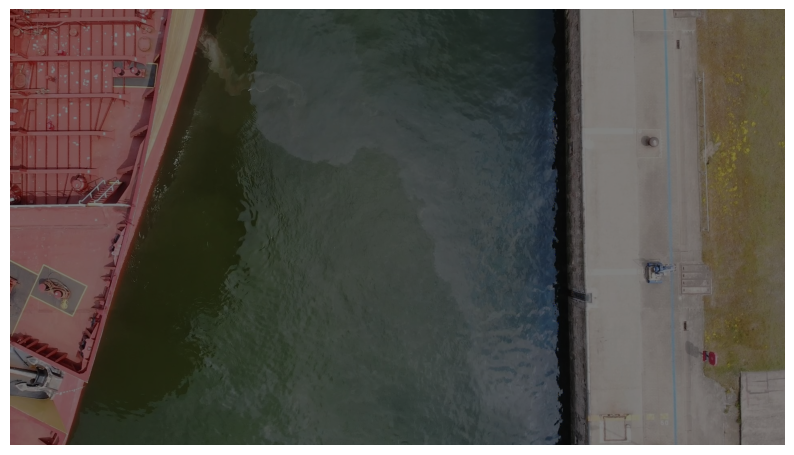

Processing image: Oil (851).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


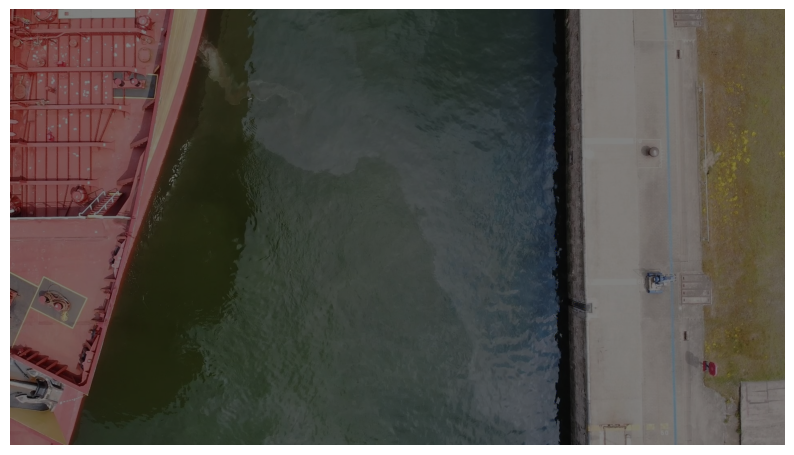

Processing image: Oil (852).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


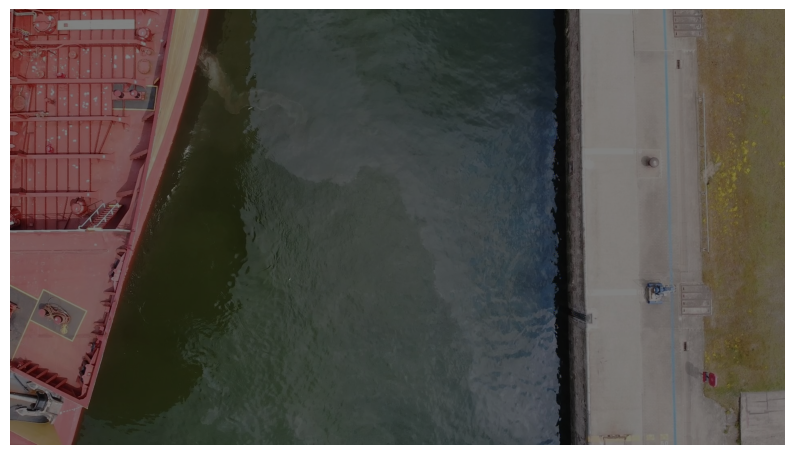

Processing image: Oil (853).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


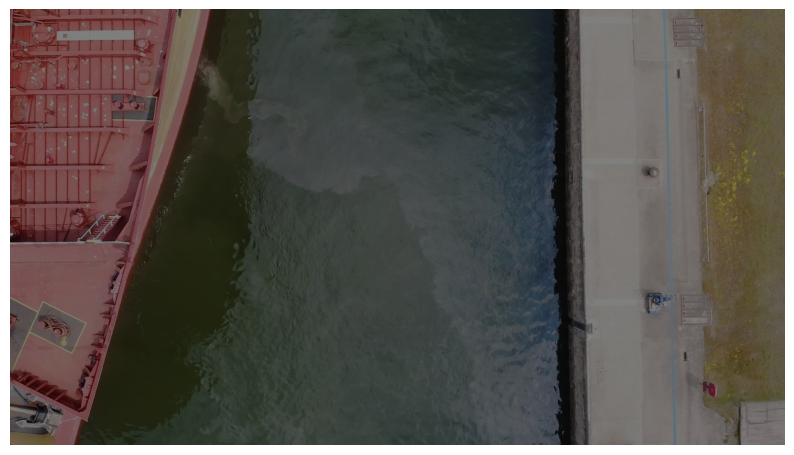

Processing image: Oil (854).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


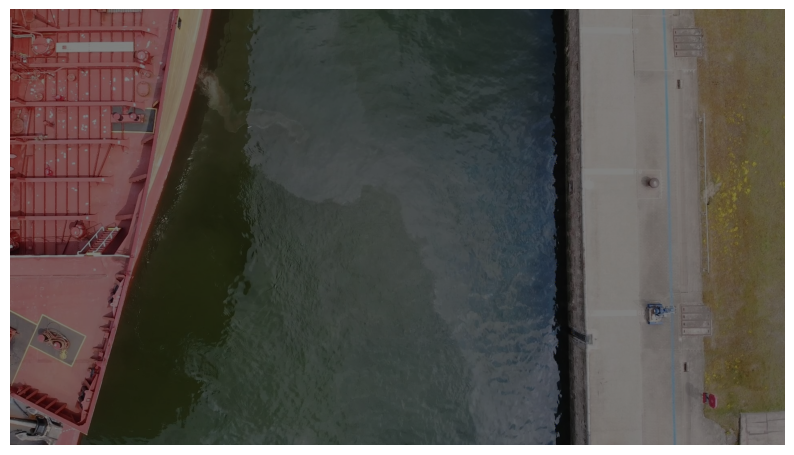

Processing image: Oil (855).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


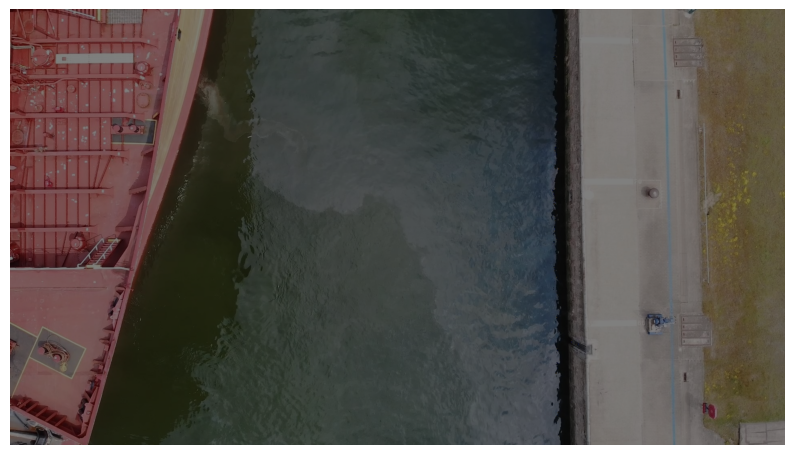

Processing image: Oil (857).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


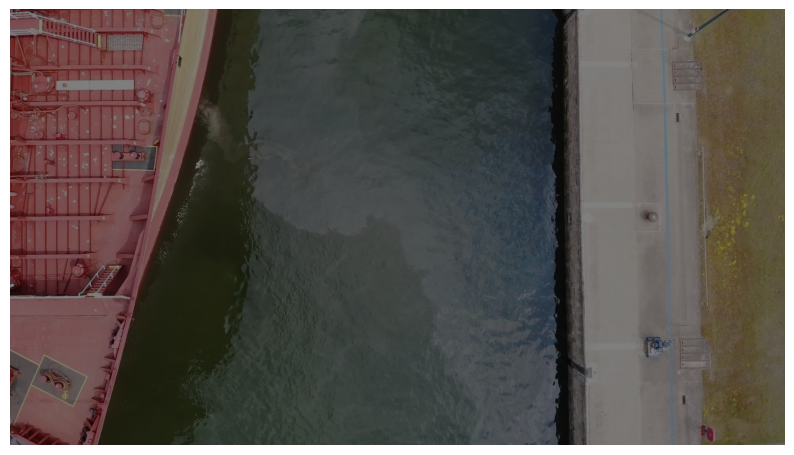

Processing image: Oil (859).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


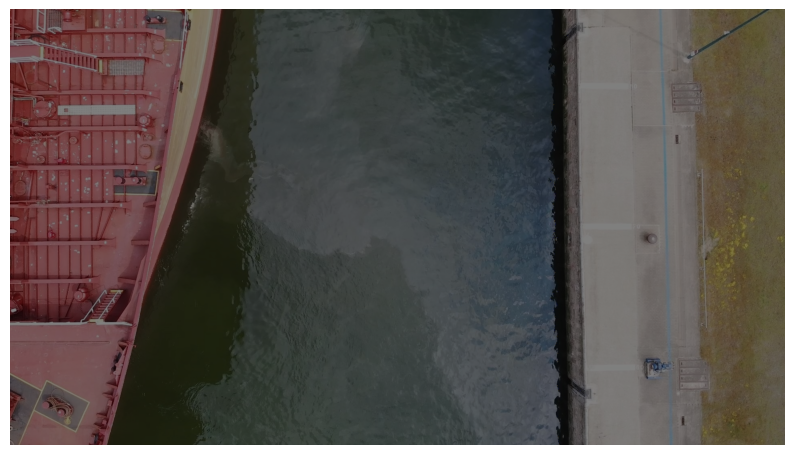

Processing image: Oil (860).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


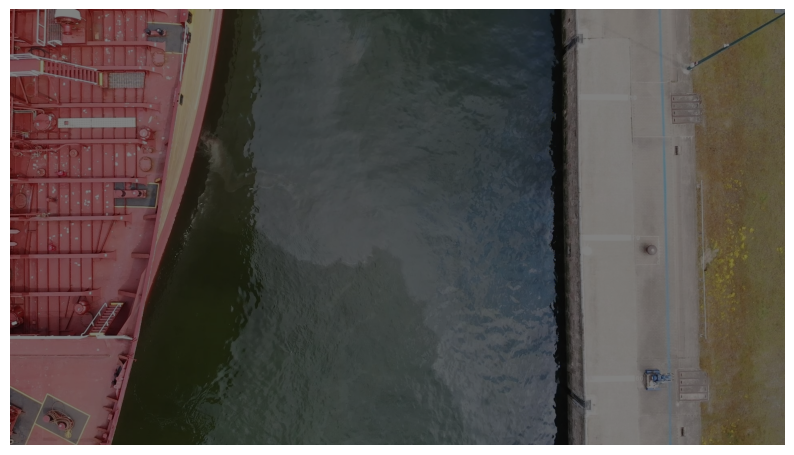

Processing image: Oil (861).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


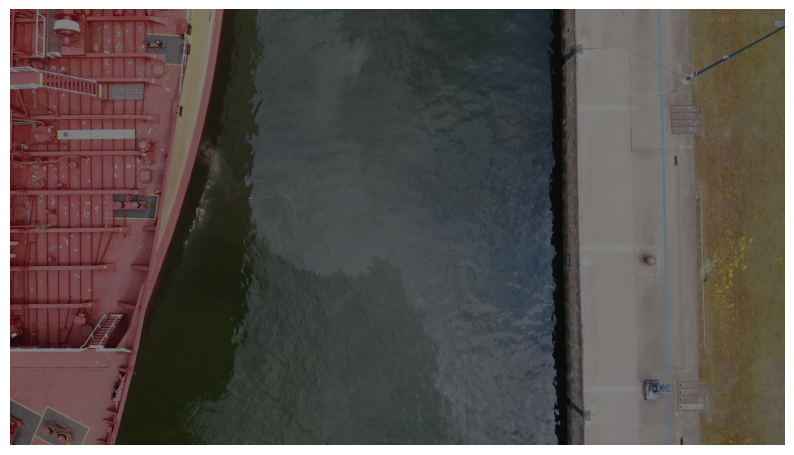

Processing image: Oil (7).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


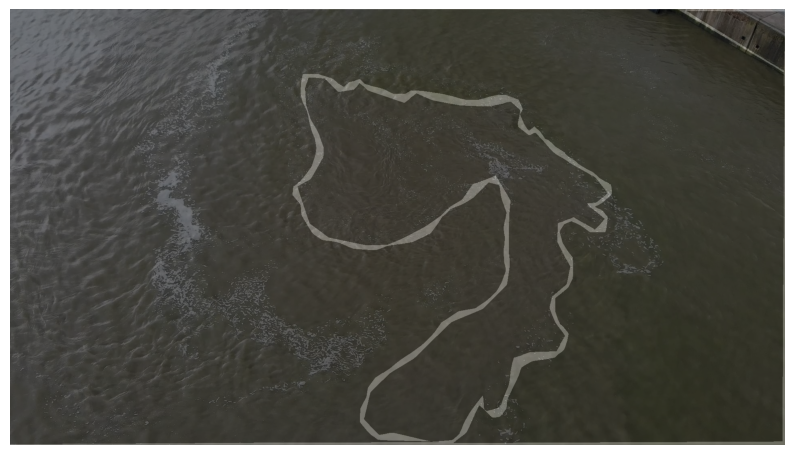

Processing image: Oil (746).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


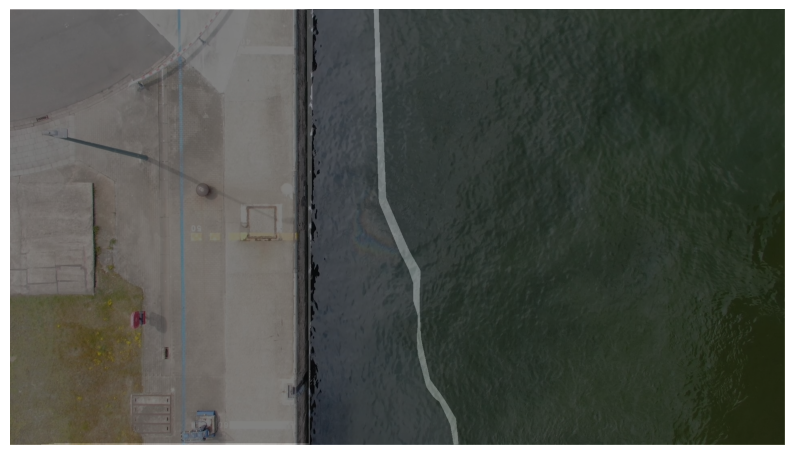

Processing image: Oil (775).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


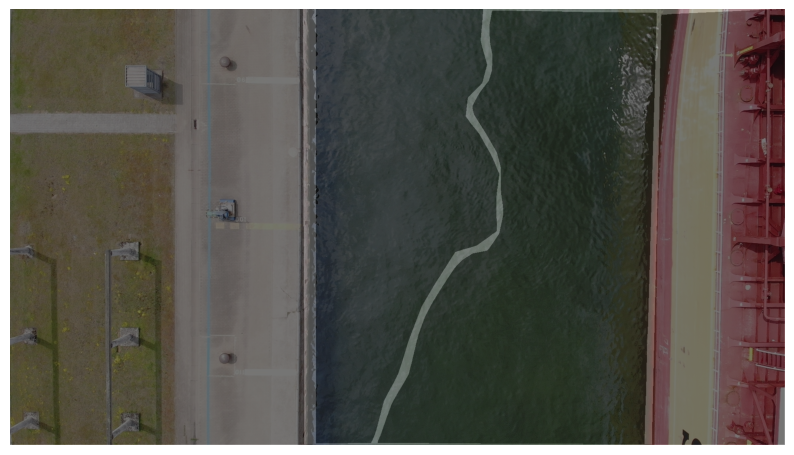

Processing image: Oil (783).jpg
Image shape: (3888, 5184, 3)
Mask shape: (3888, 5184, 3)


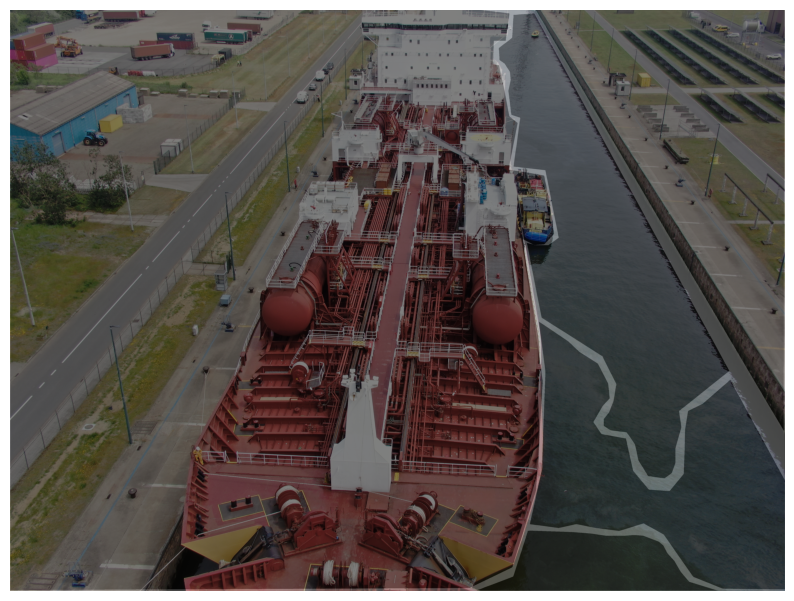

Processing image: Oil (786).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


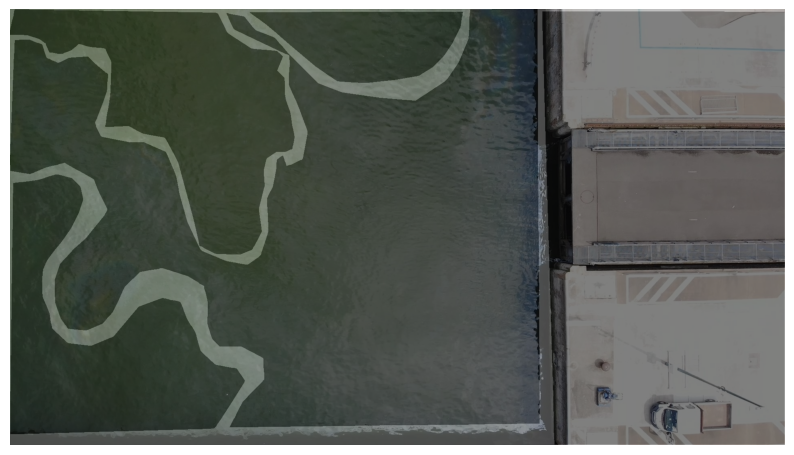

Processing image: Oil (801).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


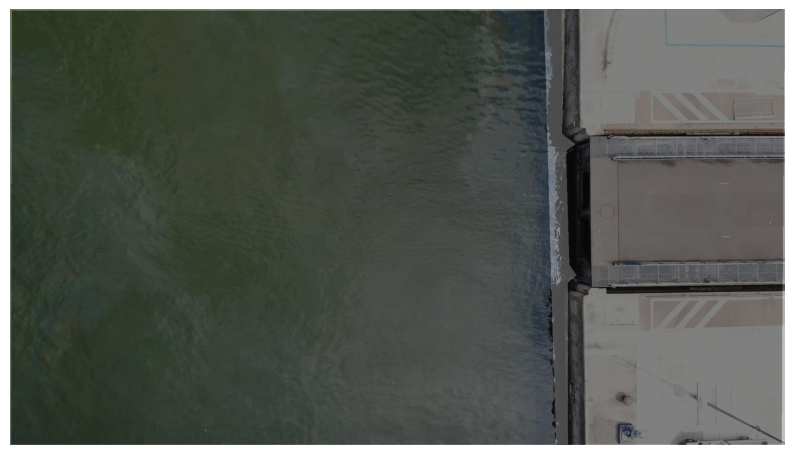

Processing image: Oil (802).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


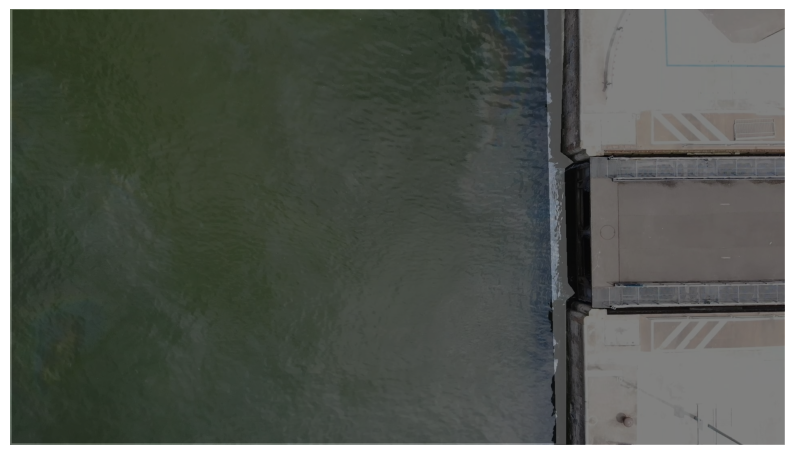

Processing image: Oil (803).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


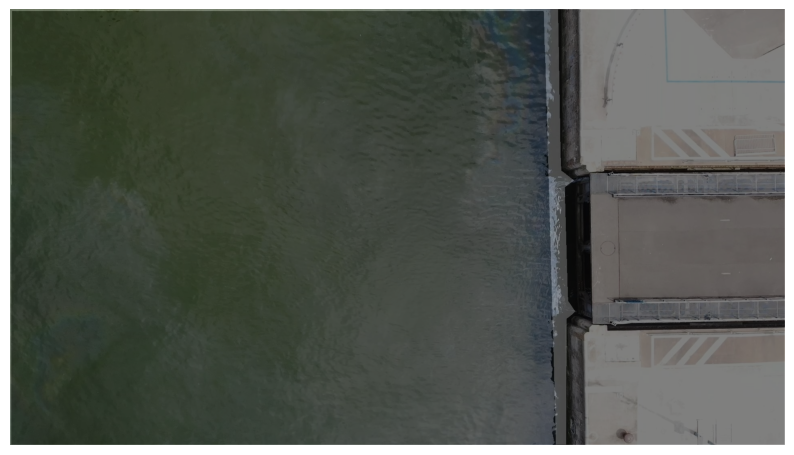

Processing image: Oil (999).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920, 3)


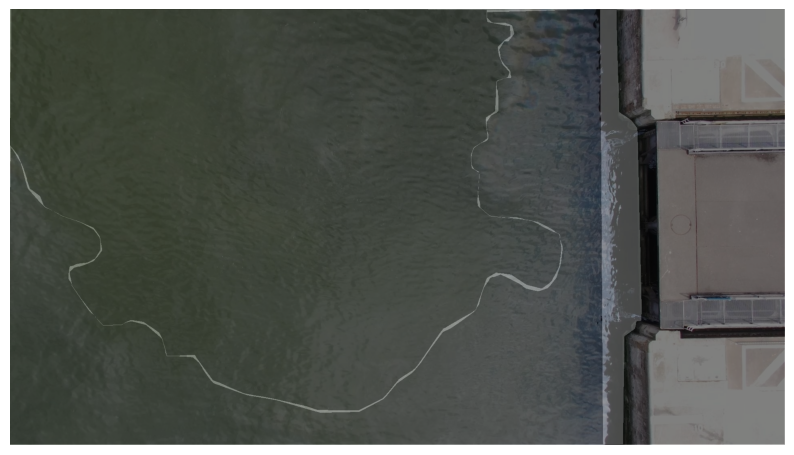

Processing image: Oil_2 (8).jpg
Image shape: (2160, 3840, 3)
Mask shape: (2160, 3840, 3)


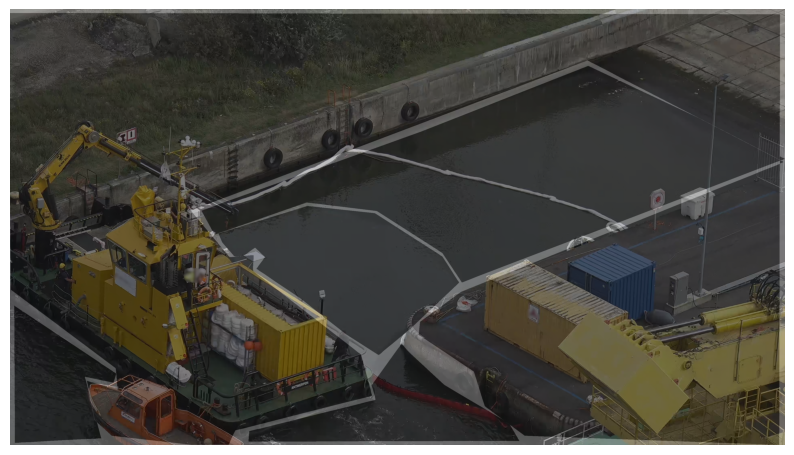

In [ ]:
def process_and_visualize_segmentation(images_dir, masks_dir):
    image_paths, mask_paths = get_image_and_mask_pairs(images_dir, masks_dir)

    for img_path, mask_path in zip(image_paths, mask_paths):
        image = load_image(img_path)
        mask = load_mask(mask_path)

        print(f"Processing image: {os.path.basename(img_path)}")
        print(f"Image shape: {image.shape}")
        print(f"Mask shape: {mask.shape}")

        visualize_segmentation(image, mask)

# Run for shadow dataset
process_and_visualize_segmentation(shadow_images_dir, shadow_masks_dir)

# Run for brightdark dataset
process_and_visualize_segmentation(brightdark_images_dir, brightdark_masks_dir)


Processing image: Oil (850).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


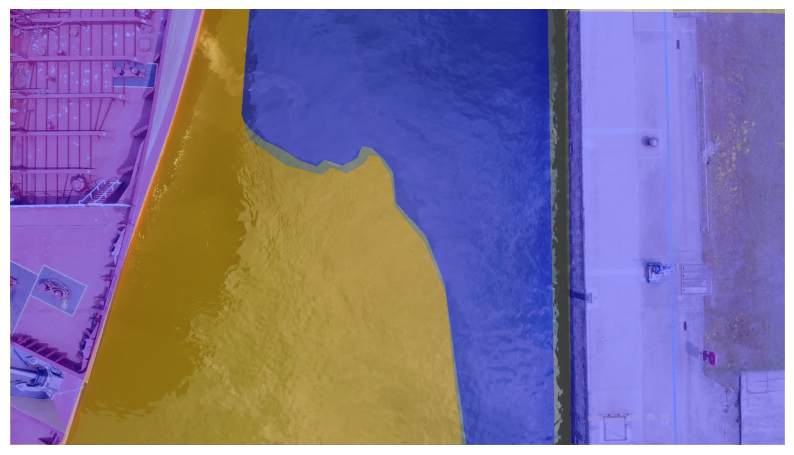

Processing image: Oil (851).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


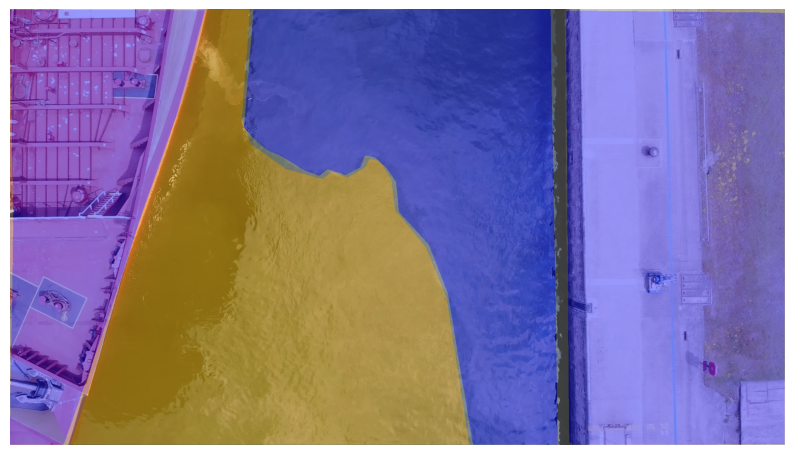

Processing image: Oil (852).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


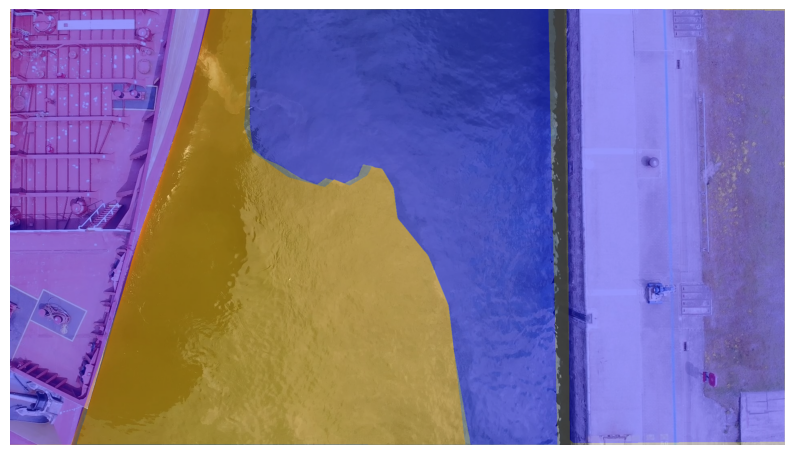

Processing image: Oil (853).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


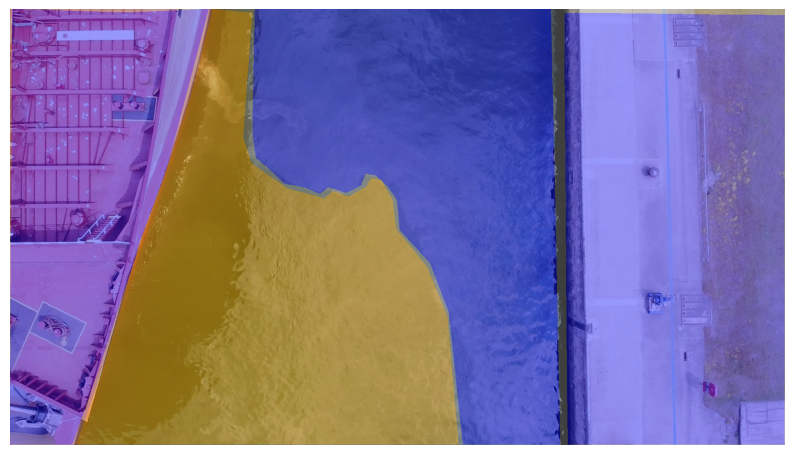

Processing image: Oil (854).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


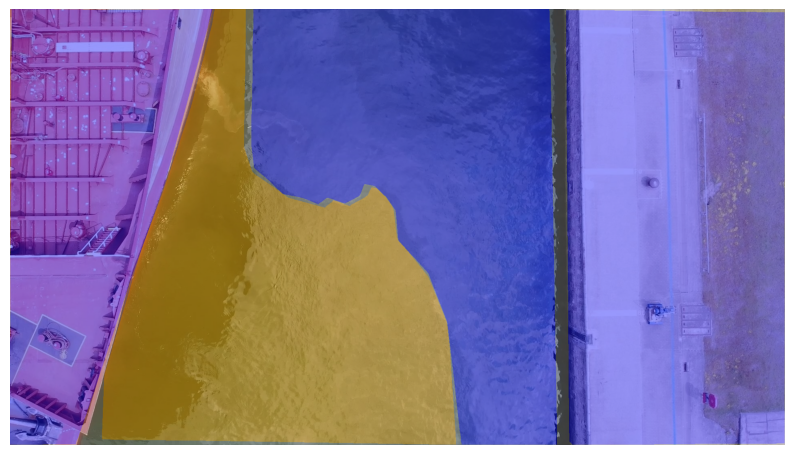

Processing image: Oil (855).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


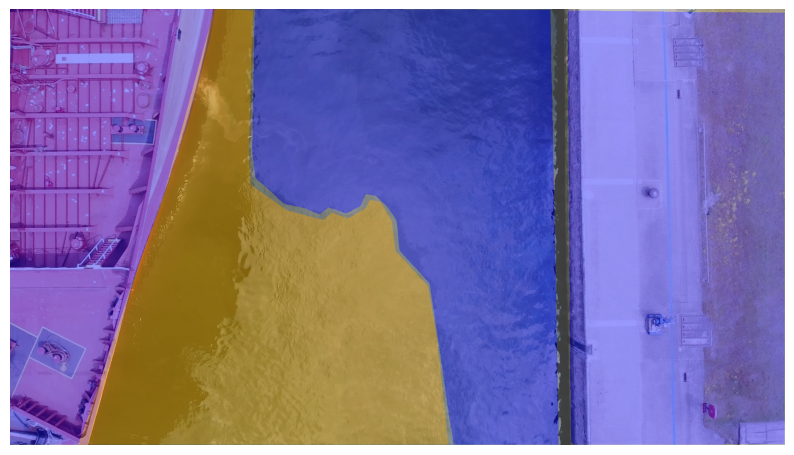

Processing image: Oil (857).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


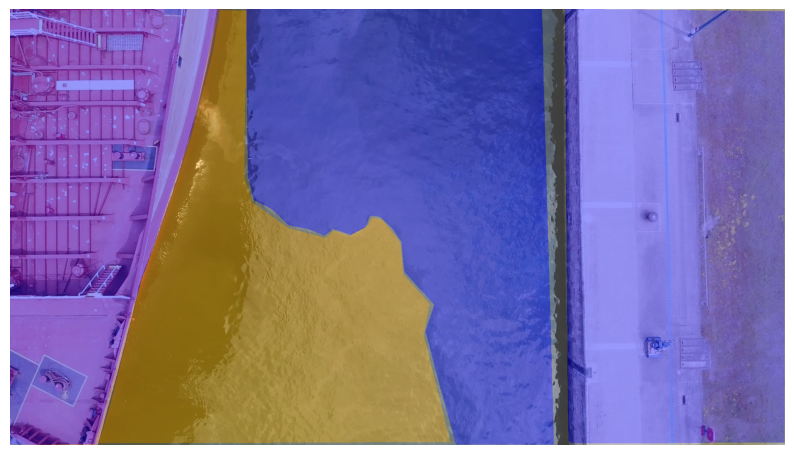

Processing image: Oil (859).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


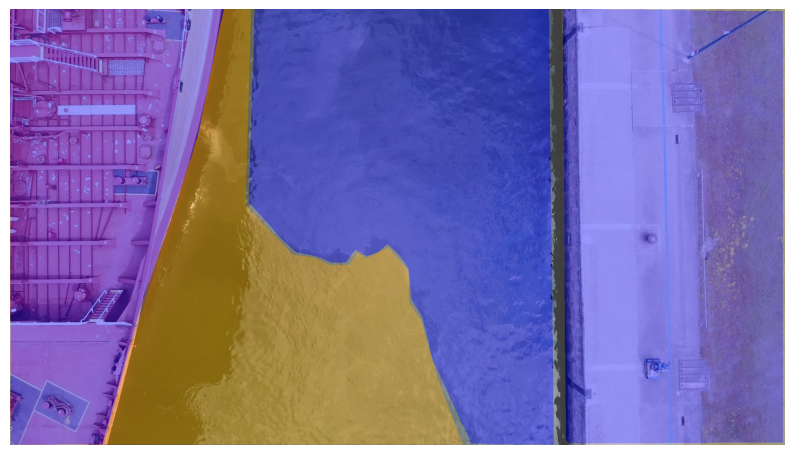

Processing image: Oil (860).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


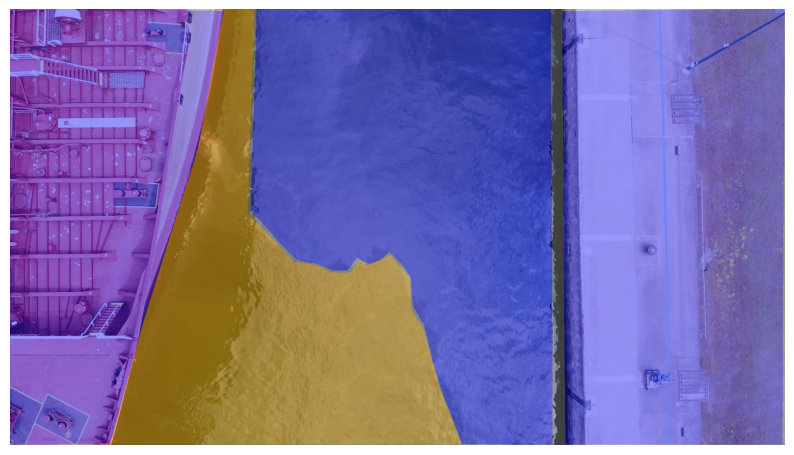

Processing image: Oil (861).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


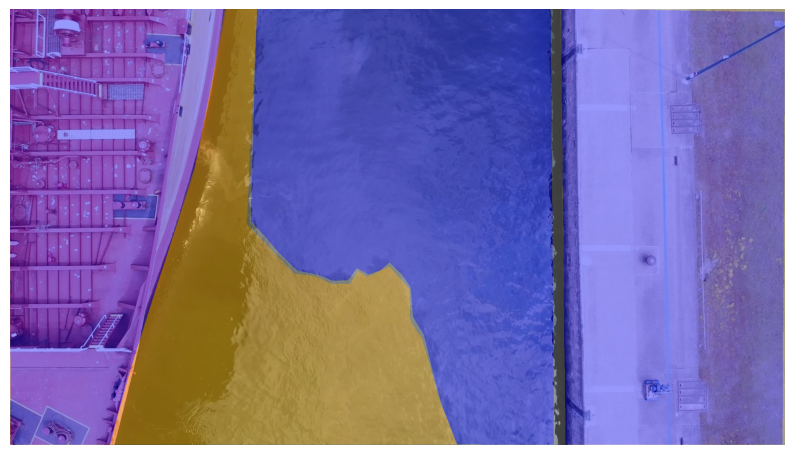

Processing image: Oil (7).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


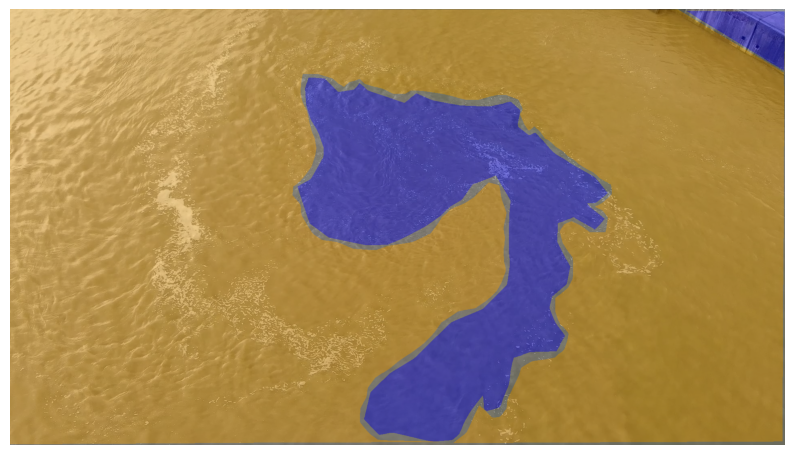

Processing image: Oil (746).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


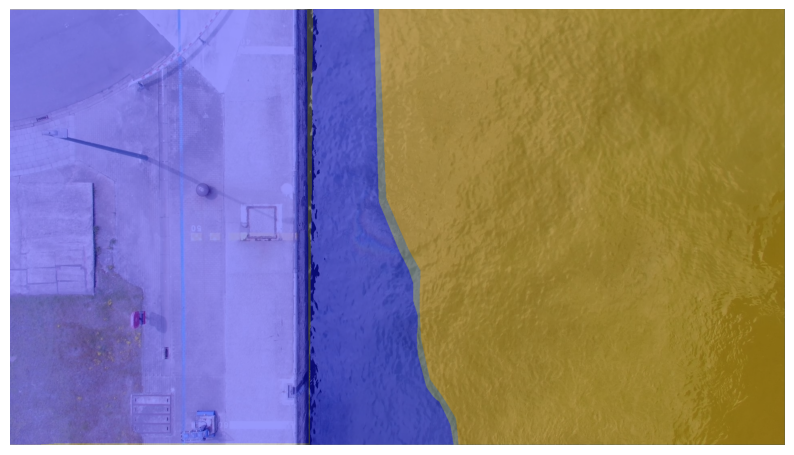

Processing image: Oil (775).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


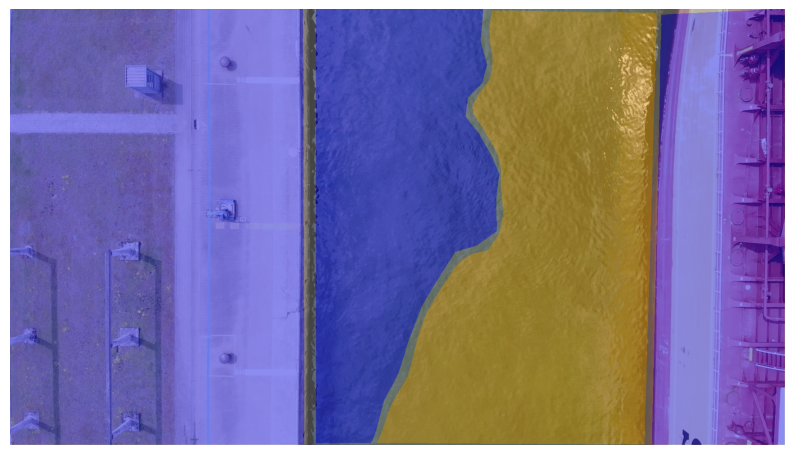

Processing image: Oil (783).jpg
Image shape: (3888, 5184, 3)
Mask shape: (3888, 5184)
Unique values in mask: [  0  51 255]


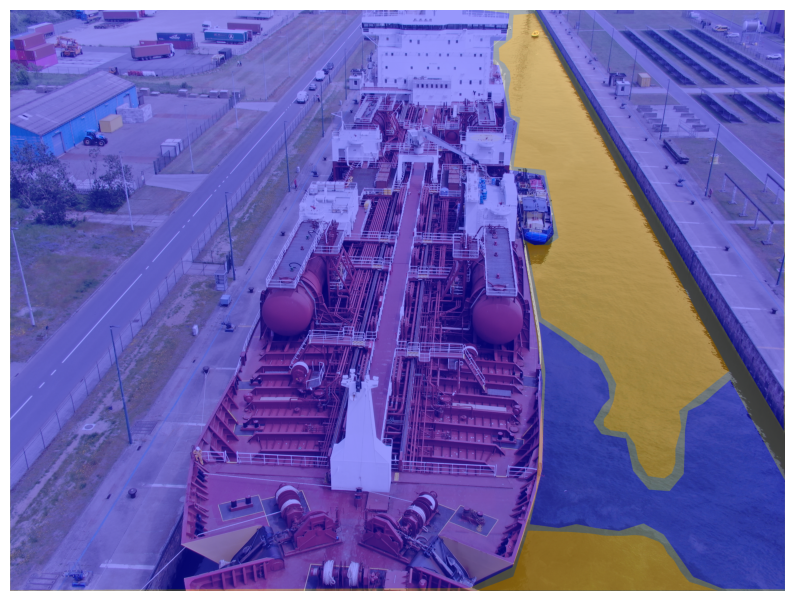

Processing image: Oil (786).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


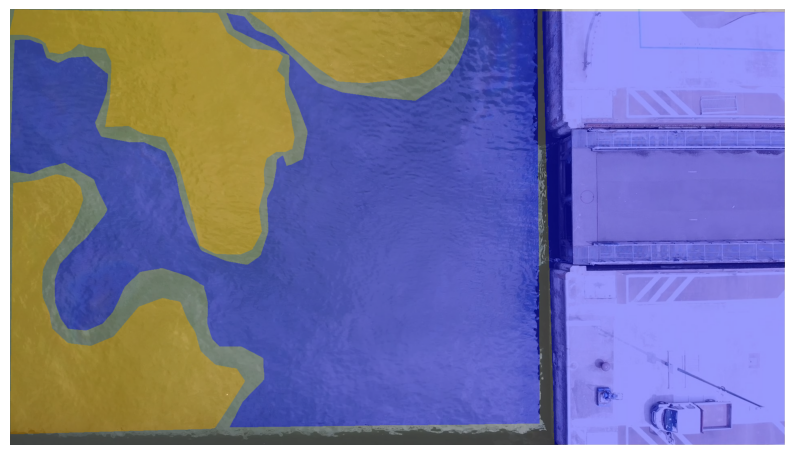

Processing image: Oil (801).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0 255]


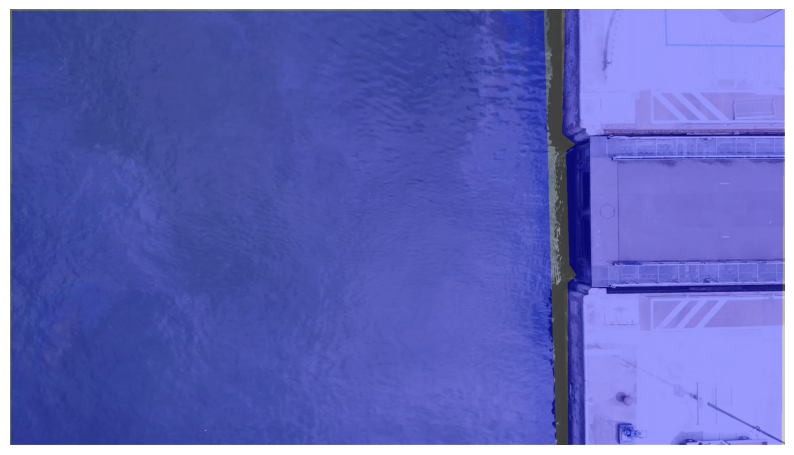

Processing image: Oil (802).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0 255]


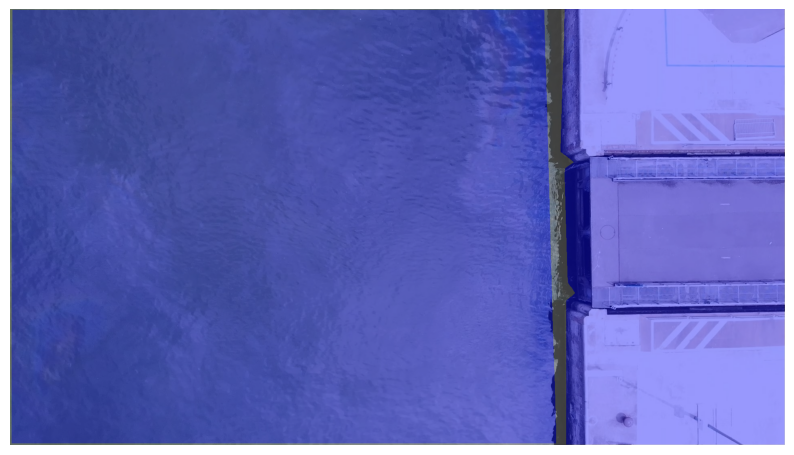

Processing image: Oil (803).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0 255]


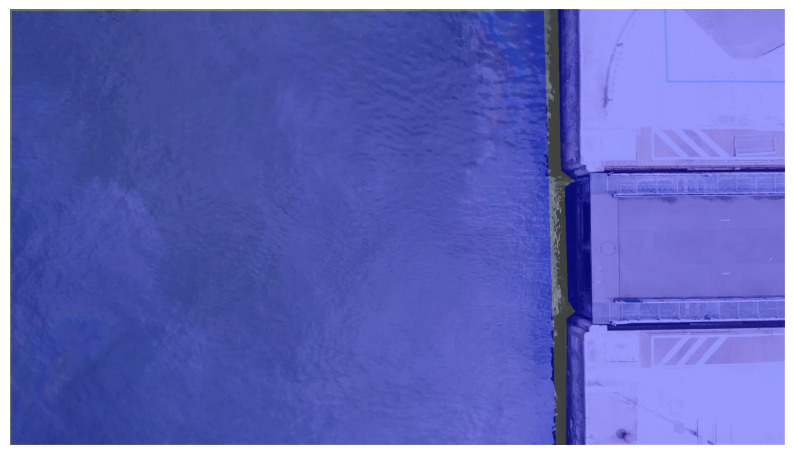

Processing image: Oil (999).jpg
Image shape: (1080, 1920, 3)
Mask shape: (1080, 1920)
Unique values in mask: [  0  51 255]


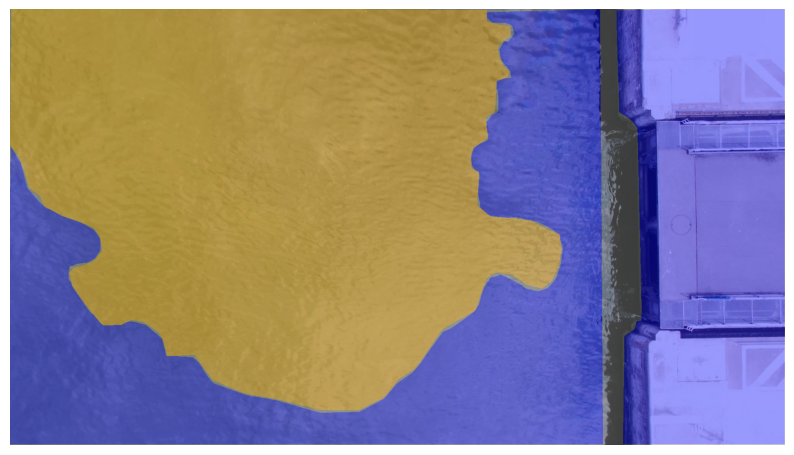

Processing image: Oil_2 (8).jpg
Image shape: (2160, 3840, 3)
Mask shape: (2160, 3840)
Unique values in mask: [  0  51 255]


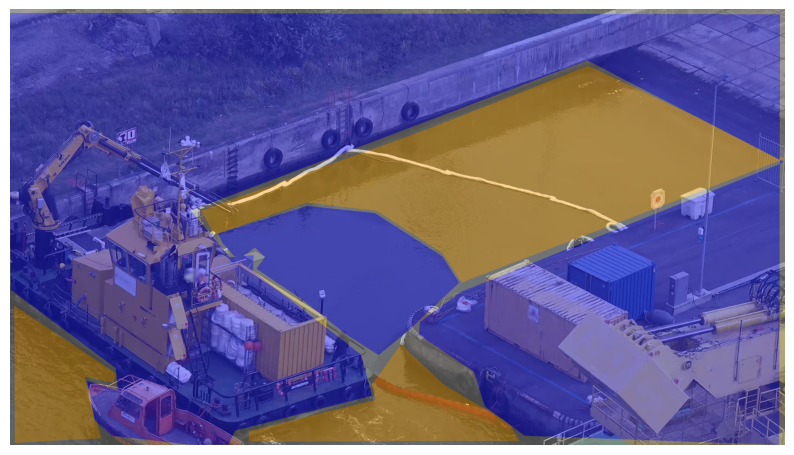

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Directories for images and masks
shadow_images_dir = r'/content/drive/MyDrive/shadow-dataset/shadow-images'
shadow_masks_dir = r'/content/drive/MyDrive/shadow-dataset/shadow-masks'

brightdark_images_dir = r'/content/drive/MyDrive/brightdark-dataset/brightdark-images'
brightdark_masks_dir = r'/content/drive/MyDrive/brightdark-dataset/brightdark-masks'

# Define correct colors for segmentation classes
colors = {
    0: [128, 128, 128],  # Grey for background or other objects
    51: [255, 165, 0],   # Orange for oil
    255: [0, 0, 255]     # Blue for water
}

def load_image(image_path):
    return np.array(Image.open(image_path))

def load_mask(mask_path):
    mask = np.array(Image.open(mask_path))
    if len(mask.shape) == 3:
        mask = mask[:, :, 0]  # Convert to 2D if mask is 3D
    return mask

def get_image_and_mask_pairs(images_dir, masks_dir):
    image_files = sorted(os.listdir(images_dir))
    mask_files = sorted(os.listdir(masks_dir))

    image_paths = [os.path.join(images_dir, f) for f in image_files]
    mask_paths = [os.path.join(masks_dir, f) for f in mask_files]

    return image_paths, mask_paths

def apply_color_mapping(mask, unique_values):
    height, width = mask.shape
    colored_mask = np.zeros((height, width, 3), dtype=np.uint8)

    for value in unique_values:
        if value in colors:
            color = np.array(colors[value])
            print(f"Applying color {color} for mask value {value}")  # Debug print
            for channel in range(3):
                colored_mask[:, :, channel][mask == value] = color[channel]
        else:
            print(f"Warning: Undefined mask value {value} found in the mask.")

    return colored_mask

def visualize_and_save_segmentation(image, mask, output_path):
    unique_values = np.unique(mask)
    print(f"Unique values in mask: {unique_values}")

    colored_mask = apply_color_mapping(mask, unique_values)

    # Convert image to the same type as mask if needed
    image = image.astype(np.float32) / 255.0

    # Combine the original image with the colored mask
    combined_image = (0.6 * image + 0.4 * (colored_mask / 255.0)).clip(0, 1)

    # Convert back to uint8
    combined_image = (combined_image * 255).astype(np.uint8)

    # Save the output image
    Image.fromarray(combined_image).save(output_path)

    # Display the image for verification
    plt.figure(figsize=(10, 10))
    plt.imshow(combined_image)
    plt.axis('off')
    plt.show()

def process_and_visualize_segmentation(images_dir, masks_dir, output_dir):
    image_paths, mask_paths = get_image_and_mask_pairs(images_dir, masks_dir)

    os.makedirs(output_dir, exist_ok=True)

    for img_path, mask_path in zip(image_paths, mask_paths):
        image = load_image(img_path)
        mask = load_mask(mask_path)

        print(f"Processing image: {os.path.basename(img_path)}")
        print(f"Image shape: {image.shape}")
        print(f"Mask shape: {mask.shape}")

        output_path = os.path.join(output_dir, f"segmented_{os.path.basename(img_path)}")
        visualize_and_save_segmentation(image, mask, output_path)

# Run for shadow dataset
process_and_visualize_segmentation(shadow_images_dir, shadow_masks_dir, '/content/drive/MyDrive/shadow-dataset/outputs')

# Run for brightdark dataset
process_and_visualize_segmentation(brightdark_images_dir, brightdark_masks_dir, '/content/drive/MyDrive/brightdark-dataset/outputs')
